# Analyzing molecular dynamics simulations

# 介绍
在这篇教程中，我们将学习如何使用MDAnalysis软件包来分析模拟的分子动力学模拟结果。我们将学习到如何加载、可视化和对齐模拟结果，以及如何计算分子动力学相关的指标，如RMSD、RDC等。




#### RMSD

跟踪构象变化的更充分的方法是计算( RMSD , [ wikipedia ] ( https://en.wikipedia.org/wiki/Root-mean-square_deviation_of_atomic_positions)).该方法测量原子位置相对于参考原子位置集合的偏差。RMSD图可以用来描述整个蛋白质或其结构域在折叠或药物结合过程中的相对运动。此外, RMSD计算还可以用于比较计算的对接构型与已知的(即晶体学的)对接构型)结合位点的均方根偏差来验证对接协议* * ( !注意:需要给对接谈话添加适当的参照物!) * *。
对于n个元素的两套原子坐标v和w，通常是叠加的，RMSD定义如下：

$$RMSD(v,w) = \sqrt{ \frac{1}{n} \sum_{i=1}^n \|v_i - w_i\|² }$$

为了在模拟中区分蛋白质的灵活和稳定部分，可以使用均方根波动( RMSF )计算来代替，这允许从它们的平均结构中可视化残基的波动。

#### Hydrogen bond analysis

氢键等非共价相互作用是配体-蛋白复合物形成的关键因素。它们的吸引力电位来自部分带正电荷的氢气指向部分带负电荷的氢键受体原子，例如氧或氮气。氢键的分析可以为配体-蛋白复合物的稳定性提供有价值的见解，并指导铅分子的修饰以改善其活性。氢键的强度可以通过分析供体、氢原子和受体原子之间的角度和距离来估计。小距离和接近180°的角度表示强键，而更大的距离和更小的角度表示较弱的键。



在计算分析中，通常使用几何阈值来确定哪些相互作用可以被认为是氢键：受体和氢之间的距离必须小于或等于一个距离阈值，供体、氢和受体之间的角度必须大于或等于一个角度阈值。例如，我们将用于分析的Python Package _ _ [ MDAnalysis ] ( https://docs.mdanalysis.org/2.0.0/documentation_pages/analysis/hydrogenbonds.html)__, )将默认的最大距离设置为3Å，最小角度设置为120 °。

## Practical


In [1]:
from pathlib import Path

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import nglview as nv
import MDAnalysis as mda
from MDAnalysis.analysis import rms, diffusionmap, align
from MDAnalysis.analysis.distances import dist
from MDAnalysis.analysis.hydrogenbonds.hbond_analysis import HydrogenBondAnalysis as HBA

/opt/anaconda3/envs/teachopencadd/lib/python3.8/site-packages/Bio/Application/__init__.py:40: BiopythonDeprecationWarning: The Bio.Application modules and modules relying on it have been deprecated.

Due to the on going maintenance burden of keeping command line application
wrappers up to date, we have decided to deprecate and eventually remove these
modules.

We instead now recommend building your command line and invoking it directly
with the subprocess module.
  warnings.warn(


In [3]:
from pathlib import Path
import os

# 获取当前工作目录
HERE = Path(os.getcwd())
DATA = HERE / 'data'
if not DATA.exists():
    DATA.mkdir(parents=True, exist_ok=True)
print(DATA)


/Users/wangyang/Desktop/AI-drug-design/list/06_extension_lab/04_md_analysis/data


### Load and visualize the system

作为第一步，我们加载拓扑( ' .pdb ' )和轨迹( ' .xtc ' )文件，以创建一个表示模拟系统的MDAnalysis '论域'。
宇宙可以很容易地在其整体中被可视化，包括轨迹的动画。
[ NGL Viewer ] ( http://nglviewer.org/)提供预构建功能，用于可视化MD Analysis等常用库中加载的模拟。

In [4]:
md_universe = mda.Universe(str(DATA / "topology.pdb"), str(DATA / "trajectory.xtc"))
view = nv.show_mdanalysis(md_universe)
view

/opt/anaconda3/envs/teachopencadd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:287: UserWarning: PDB file is missing resid information.  Defaulted to '1'
  warnings.warn("PDB file is missing resid information.  "


NGLWidget(max_frame=9)

In [5]:
view.render_image(trim=True, factor=2, transparent=True);

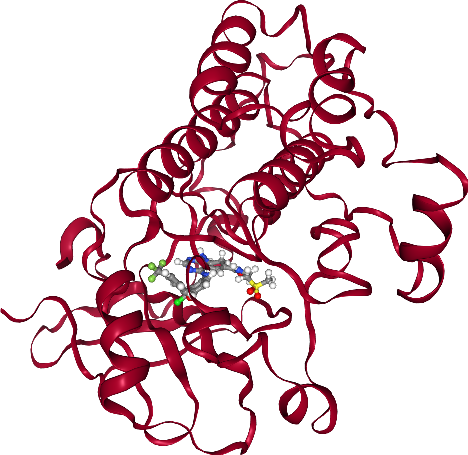

In [7]:
view._display_image()

### Alignment

虽然在这种相当短的轨迹的可视化中几乎没有注意到，但根据使用的模拟包/设置，蛋白质可以在模拟过程中旋转和转换。这可能会使对轨迹的目视检查复杂化，通常需要作为分析前一步的对齐。调整轨迹的常见选择是蛋白质。因此，蛋白质不会偏离中心，也不会旋转，允许观察不结合事件或构象变化。

[MDAnalysis]（https://docs.mdanalysis.org/stable/index.html 框架允许使用字符串在原子选择上轻松对齐，并内置了简单的选择关键字，例如“蛋白质”，它选择通常属于蛋白质的所有残基。

在下一步中，我们将把轨迹（移动）的结构对齐到参考结构上。参考结构中当前活跃的框架将用于对齐。

In [8]:
# Set trajectory pointer to first frame as reference
md_universe.trajectory[0]

# 实际修改加载的轨迹需要# in _ memory = True
# 如果轨迹对于内存来说太大，可以写出对齐后的轨迹并重新加载到新的宇宙中
alignment = align.AlignTraj(
    mobile=md_universe, reference=md_universe, select="protein", in_memory=True
)
alignment.run()

In [9]:
view = nv.show_mdanalysis(md_universe)
view

NGLWidget(max_frame=9)

In [11]:
view.render_image(trim=True, factor=2, transparent=True);

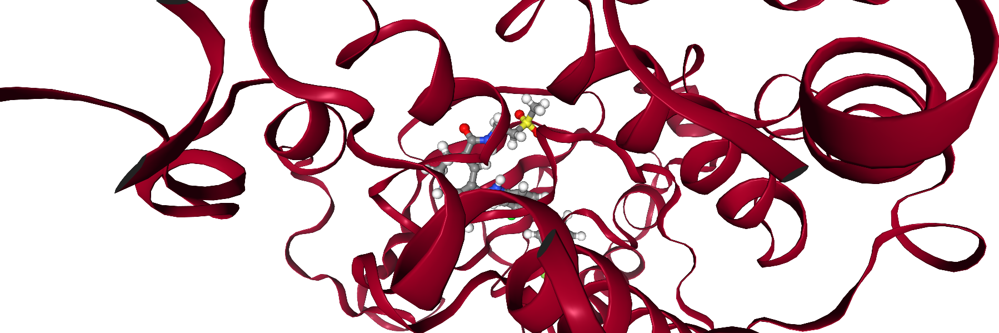

In [12]:
view._display_image()

### RMSD of protein and ligand

蛋白质和配体在动画中明显区分开来。然而，很难估计配体或蛋白质是否真正显著地改变了它们的位置/构象。因此，我们将使用一种更充分的方法来评估相对运动，即RMSD的计算。因此，我们将重点关注系统(骨架、蛋白质和配体)的不同部分。配体以其独特的残基名称被最佳选择。在这种情况下，我们知道它是抑制剂' 03P '，但我们也可以通过查看拓扑文件或将光标悬停在上述动画中的配体原子上找到名称。

In [13]:
ligand_name = "03P"

#### RMSD over time

For plotting the RMSD, we write a function that does the RMSD calculation for selected atom groups from the universe and returns a pandas `Dataframe`.

In [14]:
def rmsd_for_atomgroups(universe, selection1, selection2=None):
    """Calulate the RMSD for selected atom groups.

    Parameters
    ----------
    universe: MDAnalysis.core.universe.Universe
        MDAnalysis universe.
    selection1: str
        Selection string for main atom group, also used during alignment.
    selection2: list of str, optional
        Selection strings for additional atom groups.

    Returns
    -------
    rmsd_df: pandas.core.frame.DataFrame
        DataFrame containing RMSD of the selected atom groups over time.
    """

    universe.trajectory[0]
    ref = universe
    rmsd_analysis = rms.RMSD(universe, ref, select=selection1, groupselections=selection2)
    rmsd_analysis.run()
    columns = [selection1, *selection2] if selection2 else [selection1]
    rmsd_df = pd.DataFrame(np.round(rmsd_analysis.results.rmsd[:, 2:], 2), columns=columns)
    rmsd_df.index.name = "frame"
    return rmsd_df

Run the function to calculate the RMSD for the selected molecules during the simulation:

* whole protein
* protein backbone atoms 
* ligand

During the calculation, the molecule will be superimposed to the first frame (reference) along the backbone of the protein.

In [15]:
rmsd = rmsd_for_atomgroups(md_universe, "backbone", ["protein", f"resname {ligand_name}"])
rmsd.head()

/opt/anaconda3/envs/teachopencadd/lib/python3.8/site-packages/MDAnalysis/analysis/rms.py:279: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(np.sum((a - b) ** 2) / N)


,backbone,protein,resname 03P
frame,,,
0,0.00,0.00,NaN
1,0.62,0.94,NaN
2,0.72,1.06,NaN
3,0.77,1.14,NaN
4,0.74,1.16,NaN


Then, we plot the results.

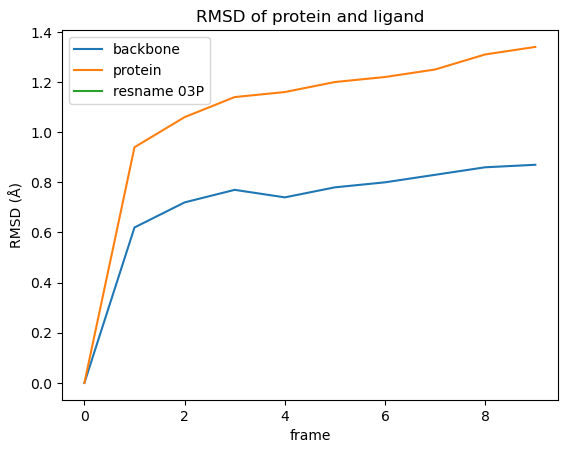

In [16]:
rmsd.plot(title="RMSD of protein and ligand")
plt.ylabel("RMSD (Å)");

在情节中我们可以看到什么：
* 在模拟过程中骨架仅有轻微的构象变化，这并不奇怪，因为蛋白质是叠加在骨架上的。
* 在RMSD计算中包含蛋白质侧链时，与只包含蛋白质骨架时相比，会导致更多的运动。
* 在我们的模拟中，配体的运动与蛋白质侧链的运动在同一范围内。然而，这种情况并不总是如此，因为配体可以更自由地移动，并且除了任何构象变化外，可能还涉及定向运动。如果配体的RMSD值异常高，情况很可能如此。

#### RMSD between frames

之前的绘图显示了给定时间与初始状态相比的距离。
现在，我们计算所有帧之间的差异(成对的)，并在热图中可视化。

In [17]:
def RMSD_dist_frames(universe, selection):
    """Calculate the RMSD between all frames in a matrix.

    Parameters
    ----------
    universe: MDAnalysis.core.universe.Universe
        MDAnalysis universe.
    selection: str
        Selection string for the atomgroup to be investigated, also used during alignment.

    Returns
    -------
    array: np.ndarray
        Numpy array of RMSD values.
    """
    pairwise_rmsd = diffusionmap.DistanceMatrix(universe, select=selection)
    pairwise_rmsd.run()
    return pairwise_rmsd.results.dist_matrix

First, we calculate the distance matrices for protein and ligand using the function above.
Then, we plot them side by side as heatmaps.

In [18]:
dist_matrix_protein = RMSD_dist_frames(md_universe, "protein")
dist_matrix_ligand = RMSD_dist_frames(md_universe, f"resname {ligand_name}")

/opt/anaconda3/envs/teachopencadd/lib/python3.8/site-packages/MDAnalysis/analysis/rms.py:279: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(np.sum((a - b) ** 2) / N)


In order to achieve comparable heatmaps, it is important to set the minima and maxima in both plots to the same values. 
We set the minimal value to 0 and derive the upper bound from the distance matrices.

In [19]:
# get maximal distance between all frames
max_dist = max(np.amax(dist_matrix_ligand), np.amax(dist_matrix_protein))

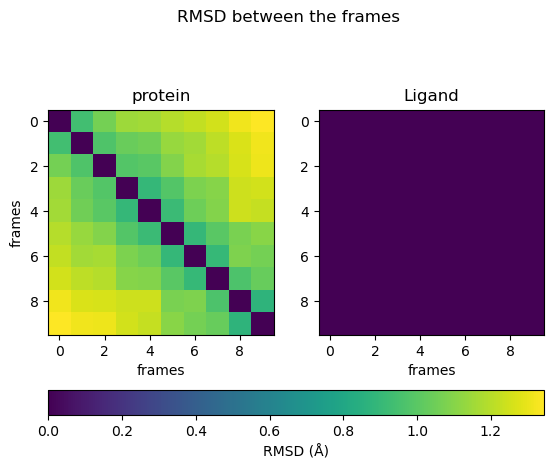

In [20]:
fig, ax = plt.subplots(1, 2)
fig.suptitle("RMSD between the frames")

# protein image
img1 = ax[0].imshow(dist_matrix_protein, cmap="viridis", vmin=0, vmax=max_dist)
ax[0].title.set_text("protein")
ax[0].set_xlabel("frames")
ax[0].set_ylabel("frames")

# ligand image
img2 = ax[1].imshow(dist_matrix_ligand, cmap="viridis", vmin=0, vmax=max_dist)
ax[1].title.set_text("Ligand")
ax[1].set_xlabel("frames")

fig.colorbar(img1, ax=ax, orientation="horizontal", fraction=0.1, label="RMSD (Å)");

From the heatmaps, we can conclude that the protein moves constantly and evenly between the states. The ligand *jumps* between different states. Sometimes it can reach similar conformations repeatedly.

### Interaction analysis

Now, we will look at the interaction between protein and ligand. Let's visualize the system again, including some more detail in the binding pocket. All residues in a 5 Å radius around the ligand are shown with atoms and bonds visible.

In [21]:
# select pocket residues
pocket_resids = set(
    md_universe.select_atoms(f"(around 5 resname {ligand_name}) and protein").resids
)
view2 = nv.show_mdanalysis(md_universe)
view2.add_representation(
    "licorice", selection=f"protein and ({' '.join([str(x) for x in pocket_resids])})"
)
view2.center(selection="ligand")
view2

NGLWidget(max_frame=9)

In [22]:
view2.render_image(trim=True, factor=2, transparent=True);

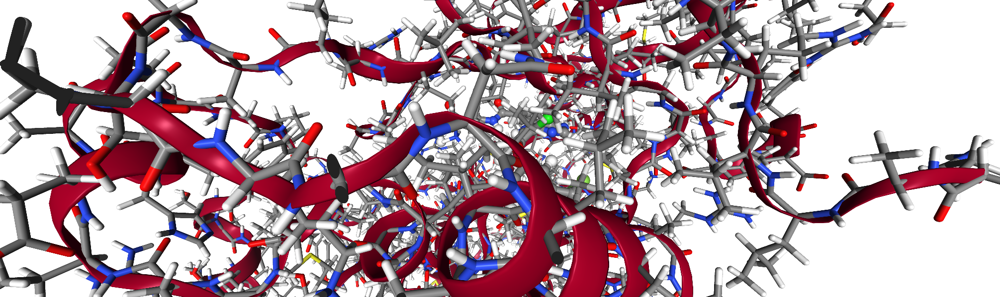

In [23]:
view2._display_image()

#### Atomic distances

We now zoom in and look for interactions that might be of interest for a project at hand. In this example, we want to look at the backbone nitrogen of methionine 793 coming in close contact with an aromatic ring of the ligand. Theoretically, the distances can be calculated for groups of atoms, as long as each group has the same number of atoms, but we want to look at distances between single atoms.
Single atom selections can be done unambiguously with the combination of residue id and atom name inside that residue. Residue names are not unique and thus are not be used here.
Atom names and their corresponding residue id can be accessed when hovering over the selected atom in the detailed view above. 

In [24]:
protein_residue_id = "793"
protein_atom_name = "N"
ligand_id = "1"
ligand_atom_name = "N4"

We select the atom groups used for our analysis, which will contain one atom each in this example.

In [25]:
atomgroup_protein = md_universe.select_atoms(
    f"resid {protein_residue_id} and name {protein_atom_name}"
)
atomgroup_ligand = md_universe.select_atoms(f"resname {ligand_name} and name {ligand_atom_name}")

Now, we can calculate the distance between the atoms in the currently set frame of our universe (using the `dist`function from `MDAnalysis`).
The function returns an array of arrays: The first two elements are the residue ids, but we are only interested in the third entry, the distance.

In [27]:
distance = dist(atomgroup_protein, atomgroup_ligand)
print(
    f"The distance between residues {protein_residue_id} and {ligand_id} is {distance[2][0]:.2f} Å"
)

ValueError: AtomGroups A and B do not have the same number of atoms

At 3.5Å the distance is close enough to play a role in mediating the binding of the ligand and is worth a closer look. The interaction between the ligand and the backbone nitrogen of methionine 793 we just measured is actually a well known bond with the hinge region in many kinases. 

To gather more information we want to look at the development of the distance over time. We can iterate over the frames and calculate the distance for each of them. The trajectory property of the universe works as a pointer and only holds information about one time step. The pointer is moved along the trajectory file, any selections are automatically updated on the way.

In [28]:
distances = []
for _ in md_universe.trajectory:
    distance = dist(atomgroup_protein, atomgroup_ligand)
    distances.append(distance[2][0])

ValueError: AtomGroups A and B do not have the same number of atoms

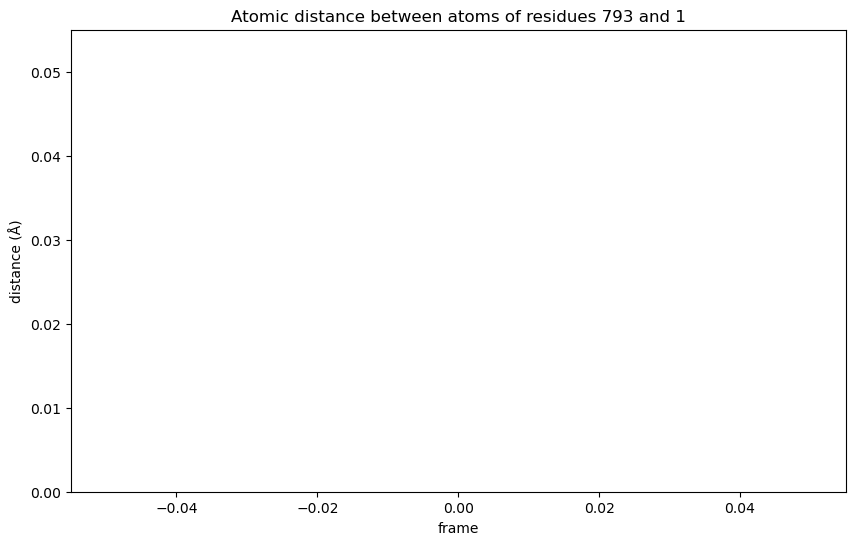

In [29]:
plt.figure(figsize=(10, 6))
plt.plot(distances)
plt.gca().set_ylim(bottom=0)
plt.ylabel("distance (Å)")
plt.xlabel("frame")
plt.title(f"Atomic distance between atoms of residues {protein_residue_id} and {ligand_id}")
plt.show()

From the graphic we see that during the interaction the distance becomes shorter than the initially observed 3.52 Å in the first frame. This means the interaction gets stronger at first and, although fluctuating, stays relatively stable for extended periods.

#### Hydrogen bond analysis

As it happens, the interaction with the hinge region we are analyzing forms a hydrogen bond. The nitrogen of the backbone from methionine is acting as the donor, the nitrogen in the aromatic ring of the ligand is the acceptor.

We go back to the visualization to get the unique name of the hydrogen forming the bond .Then, we can use the hydrogen bond analysis capability from [MDAnalysis](https://docs.mdanalysis.org/1.0.0/documentation_pages/analysis/hydrogenbonds.html) to determine the characteristic distances and angles for the hydrogen bond. The hydrogen bond analysis covers all frames without manual iteration and is convenient to plot.

In [30]:
hydrogen_name = "H"

In [31]:
def run_hydrogenbond_analysis(
    universe,
    donor_resid,
    donor_atom,
    hydrogen_atom,
    acceptor_resid,
    acceptor_atom,
    h_cutoff=1.2,
    a_cutoff=3.0,
    angle_cutoff=120,
):
    """
    Perform an hydrogen bond analysis between selcted atom groups.
    Return the data as readable, formatted data frame.

    Parameters
    ----------
    universe: MDAnalysis.core.universe.Universe
        MDAnalysis universe.
    donor_resid: str
        Residue Id of residue containing donor atom in MDAnalysis universe.
    donor_atom: str
        Name of the donor atom in the MDAnalysis universe.
    hydrogen_atom: str
        Name of involved hydrogen atom in the MDAnalysis universe.
    acceptor_resid: str
        Residue Id of residue containing acceptor atom in the MDAnalysis universe.
    acceptor_atom: str
        Name of the acceptor atom in the MDAnalysis universe.
    h_cutoff: float, optional
        Distance cutoff used for finding donor-hydrogen pairs.
    a_cutoff: float, optional
        Donor-acceptor distance cutoff for hydrogen bonds.
    angle_cutoff: int, optional
        D-H-A angle cutoff for hydrogen bonds.

    Returns
    -------
    bond : pandas.core.frame.DataFrame
        DataFrame containing hydrogen bond information over time.
    """

    # set up and run the hydrogen bond analysis (HBA)
    hbonds = HBA(
        universe=universe,
        donors_sel="resid " + donor_resid + " and name " + donor_atom,
        hydrogens_sel="resid " + donor_resid + " and name " + hydrogen_atom,
        acceptors_sel="resid " + acceptor_resid + " and name " + acceptor_atom,
        d_h_cutoff=h_cutoff,
        d_a_cutoff=a_cutoff,
        d_h_a_angle_cutoff=angle_cutoff,
    )
    hbonds.run()
    # extract bond data
    bond = pd.DataFrame(np.round(hbonds.results.hbonds, 2))
    # name columns (according to MDAnalysis function description)
    bond.columns = [
        "frame",
        "donor_index",
        "hydrogen_index",
        "acceptor_index",
        "distance",
        "angle",
    ]
    # set frame as the index
    bond["frame"] = bond["frame"].astype(int)
    bond.set_index("frame", inplace=True, drop=True)
    return bond

We run the hydrogen bond analysis using our function, which returns a data frame.

In [32]:
bond = run_hydrogenbond_analysis(
    md_universe, protein_residue_id, protein_atom_name, hydrogen_name, ligand_id, ligand_atom_name
)
bond.head()

/opt/anaconda3/envs/teachopencadd/lib/python3.8/site-packages/MDAnalysis/analysis/hydrogenbonds/hbond_analysis.py:722: UserWarning: No hydrogen bonds were found given d-a cutoff of 3.0 between Donor, resid 793 and name N, and Acceptor, resid 1 and name N4.
  warnings.warn(
/opt/anaconda3/envs/teachopencadd/lib/python3.8/site-packages/MDAnalysis/analysis/hydrogenbonds/hbond_analysis.py:751: UserWarning: No hydrogen bonds were found given angle of 120 between Donor, resid 793 and name N, and Acceptor, resid 1 and name N4.
  warnings.warn(


,donor_index,hydrogen_index,acceptor_index,distance,angle
frame,,,,,


In the table, we can see that the bond is only recognized in some frames during the simulation. 

The used module searches for hydrogen bonds with strict predefined constraints. Using default settings, the bond is only detected if the distance larger than 3Å between donor and acceptor and smaller than 1.2Å between donor and hydrogen and if the angle is larger than 120° (see Figure 1). The bond will not be included for frames that do not meet the constraints.

To trace the bond over the entire simulation, we can change those thresholds to detect the bond in its "weaker" states.
From the above table, the angles seem to be sufficiently high, while the distances are closer to the 3Å cutoff distance. Thus, we try the analysis again with a higher distance cutoff of 5Å for the donor and acceptor distance.

In [33]:
bond = run_hydrogenbond_analysis(
    md_universe,
    protein_residue_id,
    protein_atom_name,
    hydrogen_name,
    ligand_id,
    ligand_atom_name,
    a_cutoff=5.0,
)
bond.head()

/opt/anaconda3/envs/teachopencadd/lib/python3.8/site-packages/MDAnalysis/analysis/hydrogenbonds/hbond_analysis.py:722: UserWarning: No hydrogen bonds were found given d-a cutoff of 5.0 between Donor, resid 793 and name N, and Acceptor, resid 1 and name N4.
  warnings.warn(
/opt/anaconda3/envs/teachopencadd/lib/python3.8/site-packages/MDAnalysis/analysis/hydrogenbonds/hbond_analysis.py:751: UserWarning: No hydrogen bonds were found given angle of 120 between Donor, resid 793 and name N, and Acceptor, resid 1 and name N4.
  warnings.warn(


,donor_index,hydrogen_index,acceptor_index,distance,angle
frame,,,,,


Now, we plot the bond.

In [34]:
def plot_hydrogen_bond_over_time(bond):
    """
    Plot the distance and degree of a chosen hydrogen bond over time.
    Peaks in angle and dips in distance represent moments of strong binding.

    Parameters
    ----------
    bond: pandas.core.frame.DataFrame
        Hydrogen bond analysis data frame with named columns.
    """

    donor_index = bond.iloc[0].donor_index
    acceptor_index = bond.iloc[0].acceptor_index

    # add values for missing frames for gapless plotting
    bond = bond.reindex(np.arange(0, 99))

    # plot the data
    fig = plt.figure(figsize=(10, 6))
    distance = bond.distance.plot(
        title=f"H-Bond between donor {donor_index} and acceptor {acceptor_index}",
        style="o-",
        x="frame",
    )
    distance.set_ylabel("distance (Å)")
    distance.set_xlabel("frame")
    distance.set_ylim(bottom=0)
    angle = bond.angle.plot(secondary_y=True, style="o-", x="frame")
    angle.set_ylabel("angle (°)")
    angle.set_xlabel("frame")
    angle.set_ylim(bottom=0)
    fig.legend(loc="lower right", bbox_to_anchor=(1, 0), bbox_transform=distance.transAxes)
    plt.show()

In [35]:
plot_hydrogen_bond_over_time(bond)

IndexError: single positional indexer is out-of-bounds

While the distance values in the hydrogen bond analysis are the same we have seen in the pure distance plot above, the combination with the bond angle elevates the information. As mentioned before, the distance is at the upper end for hydrogen bond lengths throughout the simulation, but the bond angle is consistently close to 180° and stabilizes the bond. From the analysis we could assume that the interaction between the backbone methionine in the kinase hinge region is indeed a crucial factor for the binding of the ligand.

In [36]:
view_strong = nv.show_mdanalysis(md_universe)
view_strong.add_representation("ball+stick", selection=f"protein and {protein_residue_id}")
view_strong.center(selection="ligand")
view_strong.frame = 71
view_strong

NGLWidget(frame=71, max_frame=9)

In [37]:
view_bad = nv.show_mdanalysis(md_universe)
view_bad.add_representation("ball+stick", selection=f"protein and {protein_residue_id}")
view_bad.center(selection="ligand")
view_bad.frame = 1
view_bad

NGLWidget(frame=1, max_frame=9)

## 讨论
分析MD模拟的方法有很多种。在这篇文章中，我们只探索了一小部分可用的方法，以提供用户的第一洞察力。有些方法比较直接，比如系统的可视化或者RMSD的计算，而有些方法则需要更加精细。特别是氢键分析还依赖于人工输入和调整。但是，随着该领域的进一步发展，我们可以期望框架变得越来越精致。
在分析过程中使用的MD模拟实际上太短，无法提供关于蛋白质或配体的结合和非结合事件甚至构象变化的有统计意义的数据。为了充分利用MD模拟的能力，需要访问高性能集群。

## 测验
- 你认为哪个氢键最强?
- A：给体-受体距离= 3.5Å，给体-氢受体角度= 180 °
- B：施主受主距离= 2.7Å，施主受氢角度= 170 °
- C：给体受体距离= 3.2Å，给体氢受体角度= 150 °
- 尝试在配体上对齐轨迹。这对RMSD图有何影响?
- 选择第二对原子，分析其相互作用。
- 是否能够实现一个计算蛋白质残基均方根波动( RMSF )的函数?